In [19]:
import pandas as pd

In [20]:
df = pd.read_csv('dataset/katalog_gempa.csv')
df.iloc[:,:7]

,tgl,ot,lat,lon,depth,mag,remark
0,2008/11/01,21:02:43.058,-9.18,119.06,10,4.9,Sumba Region - Indonesia
1,2008/11/01,20:58:50.248,-6.55,129.64,10,4.6,Banda Sea
2,2008/11/01,17:43:12.941,-7.01,106.63,121,3.7,Java - Indonesia
3,2008/11/01,16:24:14.755,-3.30,127.85,10,3.2,Seram - Indonesia
4,2008/11/01,16:20:37.327,-6.41,129.54,70,4.3,Banda Sea
...,...,...,...,...,...,...,...
92882,2023/01/26,02:25:09.288,3.24,127.18,10,4.0,Talaud Islands - Indonesia
92883,2023/01/26,02:15:03.893,2.70,127.10,10,3.9,Northern Molucca Sea
92884,2023/01/26,01:57:08.885,-7.83,121.07,10,3.8,Flores Sea
92885,2023/01/26,01:46:21.009,3.00,127.16,10,4.1,Northern Molucca Sea


In [21]:
df['tgl'] = df['tgl'].apply(pd.to_datetime)

In [22]:
df.describe()

,tgl,lat,lon,depth,mag,strike1,dip1,rake1,strike2,dip2,rake2
count,92887,92887.000000,92887.000000,92887.000000,92887.000000,2735.000000,2735.000000,2735.000000,2735.000000,2735.000000,2735.000000
mean,2017-12-13 07:01:42.279113472,-3.404577,119.159707,49.009399,3.592788,170.142852,60.202121,30.358062,197.450303,56.576344,35.250018
min,2008-11-01 00:00:00,-11.000000,94.020000,2.000000,1.000000,0.000000,2.300000,-180.000000,0.000000,1.500000,-180.000000
25%,2015-11-14 00:00:00,-7.885000,113.170000,10.000000,3.000000,107.550000,46.950000,-28.500000,63.115000,39.400000,-19.900000
50%,2018-10-13 00:00:00,-2.910000,121.160000,16.000000,3.500000,144.600000,62.300000,57.600000,240.720000,58.400000,56.500000
75%,2020-12-06 00:00:00,0.140000,126.900000,54.000000,4.200000,217.500000,76.400000,100.150000,297.480000,74.700000,112.600000
max,2023-01-26 00:00:00,6.000000,142.000000,750.000000,7.900000,359.200000,90.000000,180.000000,359.980000,90.000000,180.000000
std,NaN,4.354584,10.833202,76.761070,0.834042,88.359267,19.699252,99.957906,118.920519,21.274923,98.235894


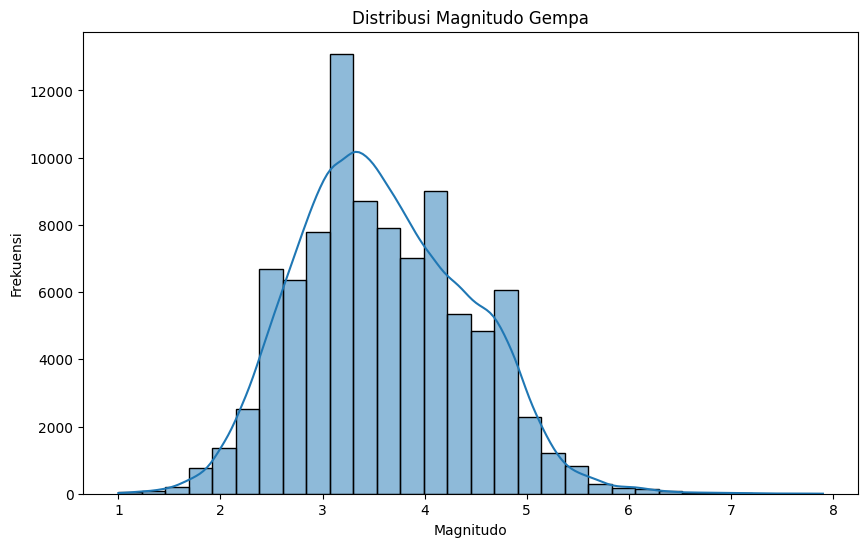

In [23]:
import matplotlib.pyplot as plt
import seaborn as sns

# Histogram distribusi magnitudo
plt.figure(figsize=(10,6))
sns.histplot(df['mag'], bins=30, kde=True)
plt.title('Distribusi Magnitudo Gempa')
plt.xlabel('Magnitudo')
plt.ylabel('Frekuensi')
plt.show()

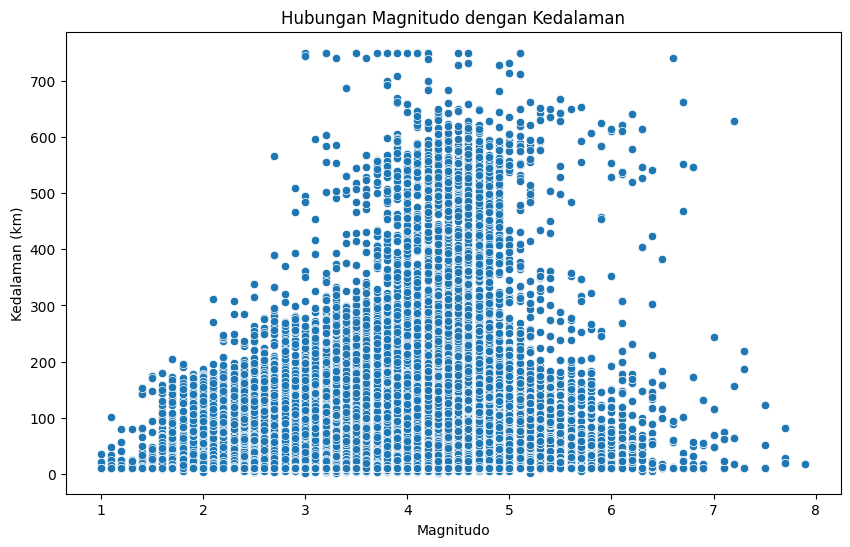

In [24]:
plt.figure(figsize=(10,6))
sns.scatterplot(x=df['mag'], y=df['depth'])
plt.title('Hubungan Magnitudo dengan Kedalaman')
plt.xlabel('Magnitudo')
plt.ylabel('Kedalaman (km)')
plt.show()


In [25]:
import folium
from folium.plugins import HeatMap

# Lokasi gempa
locations = list(zip(df['lat'], df['lon']))

# Peta Interaktif
m = folium.Map(location=[-0.5, 120], zoom_start=5)  # Set area berdasarkan data lat dan lon
HeatMap(locations).add_to(m)

m


In [26]:
import folium
from folium.plugins import MarkerCluster

# Lokasi gempa
locations = list(zip(df['lat'], df['lon']))

# Peta Interaktif
m = folium.Map(location=[-0.5, 120], zoom_start=5)

# Menambahkan Marker Cluster
marker_cluster = MarkerCluster().add_to(m)

# Menambahkan marker ke dalam cluster
for loc in locations:
    folium.Marker(location=loc).add_to(marker_cluster)

m
